

# image colorization 



## instal and import libraries
there are five python files (load_data.py , uNet.py, cGAN.py, train_loop.py, data_FID_IS.py ) , upload them to session storage.

In [1]:
pip install torchdata

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
pip install torchmetrics[image]

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [3]:
import matplotlib.pyplot as plt
import os
import torch
import torch.nn as nn
import torchvision.transforms as transforms
from torchvision.transforms import ToTensor
from torchvision.transforms import functional
from torchvision.transforms import Resize
from torch.utils.data import Dataset, DataLoader
import time as time
import numpy as np
from IPython import display
from torchdata.datapipes.iter import FileLister
from PIL import Image
from skimage import color
import torchvision.models
import random
from skimage.color import rgb2lab, lab2rgb

from load_data import data
from uNet import U_net,weights_init
from cGAN import CGAN
from train_loop import train, generate_images


In [4]:
device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cuda'

## Loading data

we use ImageNet 1000 (mini) , download it directly from https://www.kaggle.com/datasets/ifigotin/imagenetmini-1000

we also prepared a sharelink from google dive: https://drive.google.com/drive/folders/1o2ND_QksrmrXlFeGZu_Hfy9-dTo_J3vx?usp=sharing Add a shortcut to your own google drive and mount drive on google colab. this way you should be able to access the dataset.

In [5]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [6]:
PATH = ['/content/drive/MyDrive/imagenet-mini/train', '/content/drive/MyDrive/imagenet-mini/val']
number_of_data= [4750,270] #[number of training dataset, number of validation and test dataset]
saving = [False, False] #after first run, change both to False
batch_size = [2,1] #[batch size of train set, batch size of validation set]

data_train, data_val, val_visual, data_test = data(PATH, number_of_data, saving, batch_size)

print(len(data_train))
print(len(data_val))
print(len(val_visual))
print(len(data_test))

2375
250
250
20


## Unet and patchGAN

In [7]:
generator = U_net()
generator.apply(weights_init)

U_net(
  (l1): downsample(
    (model): Sequential(
      (0): Conv2d(1, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): LeakyReLU(negative_slope=0.01)
    )
  )
  (l2): downsample(
    (model): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.01)
    )
  )
  (l3): downsample(
    (model): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.01)
    )
  )
  (l4): downsample(
    (model): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(

In [8]:
from torchsummary import summary
generator.to(device)
summary(generator, input_size=(1, 256, 256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 128, 128]           1,024
         LeakyReLU-2         [-1, 64, 128, 128]               0
        downsample-3         [-1, 64, 128, 128]               0
            Conv2d-4          [-1, 128, 64, 64]         131,072
       BatchNorm2d-5          [-1, 128, 64, 64]             256
         LeakyReLU-6          [-1, 128, 64, 64]               0
        downsample-7          [-1, 128, 64, 64]               0
            Conv2d-8          [-1, 256, 32, 32]         524,288
       BatchNorm2d-9          [-1, 256, 32, 32]             512
        LeakyReLU-10          [-1, 256, 32, 32]               0
       downsample-11          [-1, 256, 32, 32]               0
           Conv2d-12          [-1, 512, 16, 16]       2,097,152
      BatchNorm2d-13          [-1, 512, 16, 16]           1,024
        LeakyReLU-14          [-1, 512,

In [9]:
discriminator = CGAN()
discriminator.apply(weights_init)

CGAN(
  (l1): downsample(
    (model): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): LeakyReLU(negative_slope=0.01)
    )
  )
  (l2): downsample(
    (model): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.01)
    )
  )
  (l3): downsample(
    (model): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.01)
    )
  )
  (l4): ZeroPad2d((1, 1, 1, 1))
  (l5): Sequential(
    (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.01)
  )
  (l6): ZeroPad2d((1, 1, 1, 1))
  (l7): Conv2d(512, 1, kernel_size=(4, 4), stride

In [10]:
discriminator.to(device)
summary(discriminator, input_size=[(1, 256, 256),(2, 256, 256)])

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 128, 128]           3,072
         LeakyReLU-2         [-1, 64, 128, 128]               0
        downsample-3         [-1, 64, 128, 128]               0
            Conv2d-4          [-1, 128, 64, 64]         131,072
       BatchNorm2d-5          [-1, 128, 64, 64]             256
         LeakyReLU-6          [-1, 128, 64, 64]               0
        downsample-7          [-1, 128, 64, 64]               0
            Conv2d-8          [-1, 256, 32, 32]         524,288
       BatchNorm2d-9          [-1, 256, 32, 32]             512
        LeakyReLU-10          [-1, 256, 32, 32]               0
       downsample-11          [-1, 256, 32, 32]               0
        ZeroPad2d-12          [-1, 256, 34, 34]               0
           Conv2d-13          [-1, 512, 31, 31]       2,097,152
        LeakyReLU-14          [-1, 512,

## Training

In [11]:
gen_opt = torch.optim.Adam(generator.parameters(), lr=2e-4, betas=(0.5, 0.999),eps=1e-07)
dis_opt = torch.optim.Adam(discriminator.parameters(), lr=2e-4, betas=(0.5, 0.999),eps=1e-07)

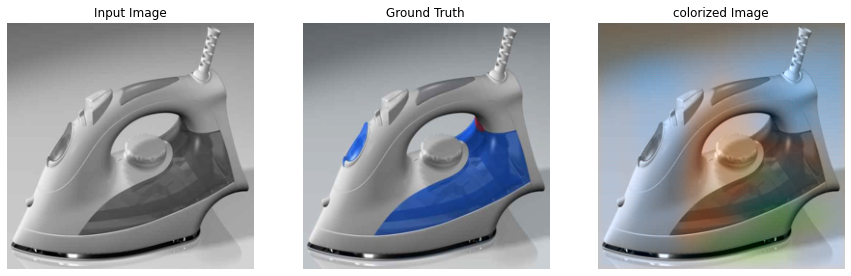

Time for epoch 1 is 138.1138858795166 sec


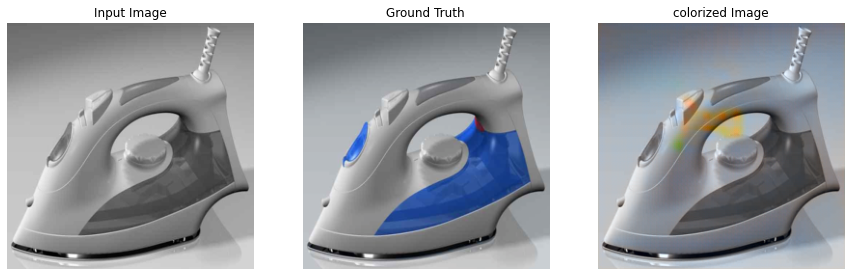

Time for epoch 6 is 68.28857827186584 sec


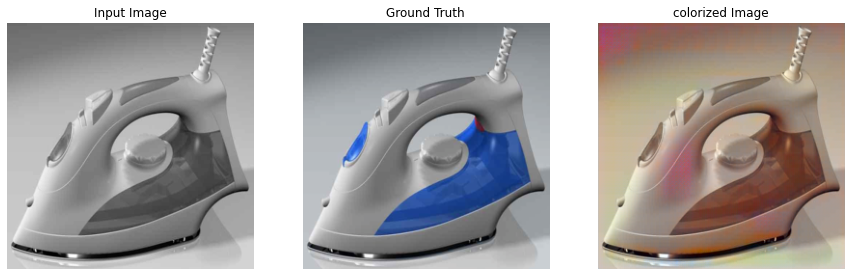

Time for epoch 11 is 68.4898567199707 sec


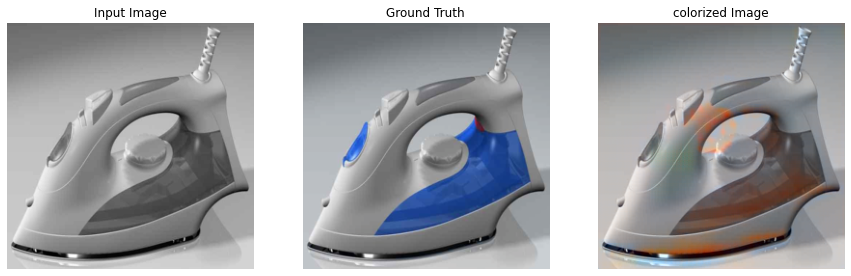

Time for epoch 16 is 68.62190794944763 sec


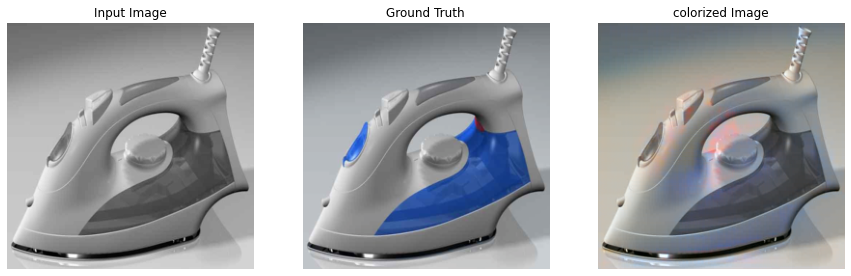

Time for epoch 21 is 68.23759150505066 sec


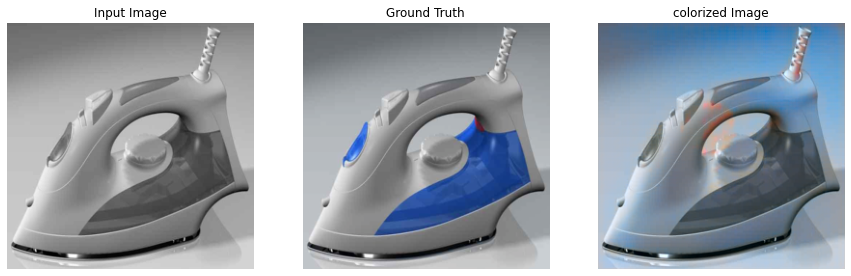

Time for epoch 26 is 70.71845507621765 sec


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 5 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


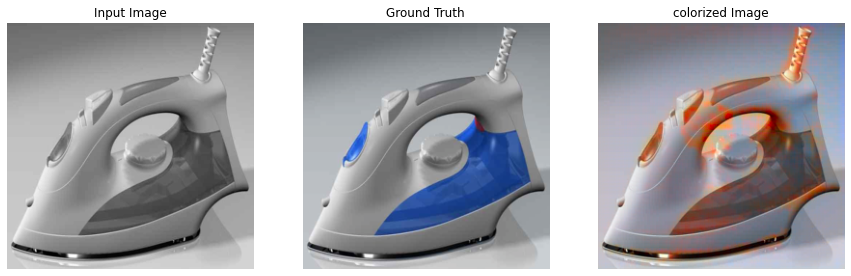

Time for epoch 31 is 68.54705858230591 sec


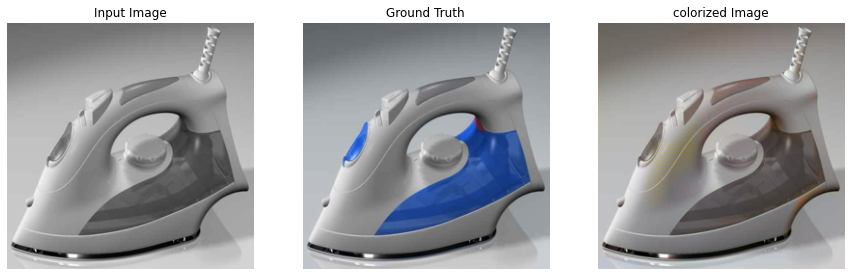

Time for epoch 36 is 68.9081609249115 sec


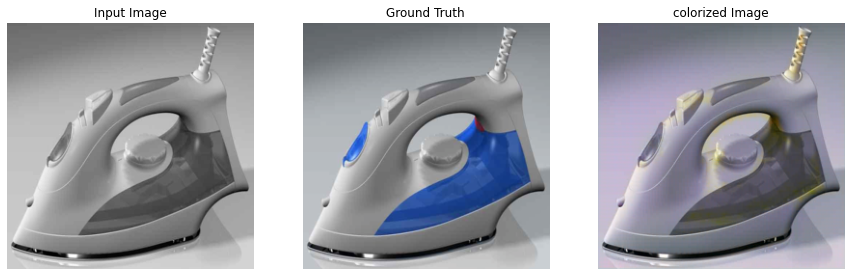

Time for epoch 41 is 68.85906410217285 sec


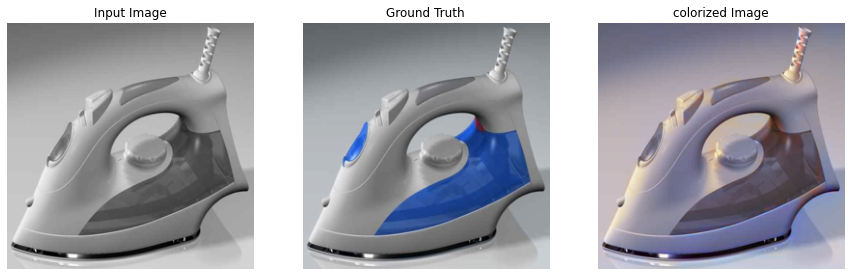

Time for epoch 46 is 68.25646996498108 sec


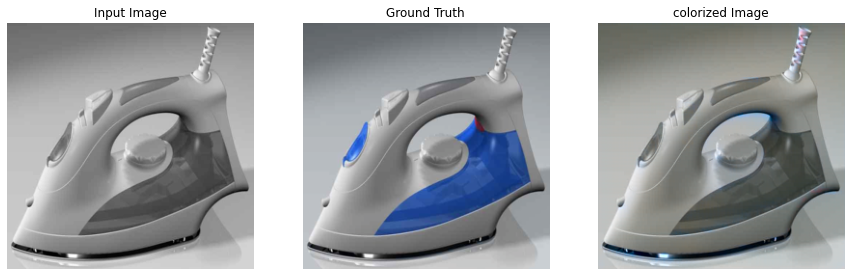

Time for epoch 51 is 68.61729288101196 sec


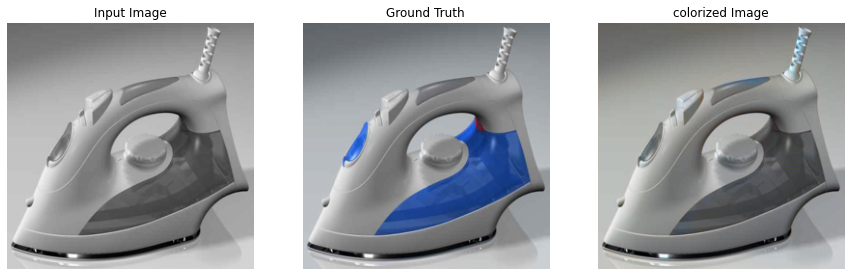

Time for epoch 56 is 68.88714861869812 sec


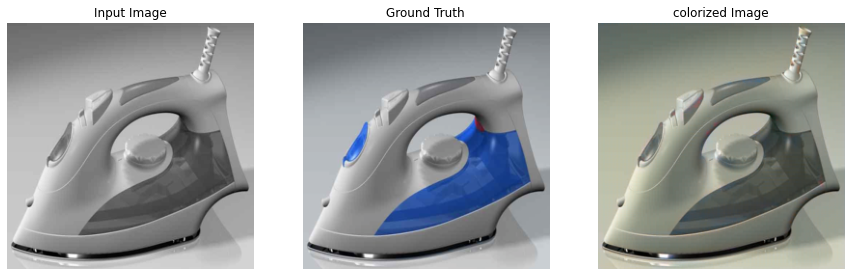

Time for epoch 61 is 68.86558246612549 sec


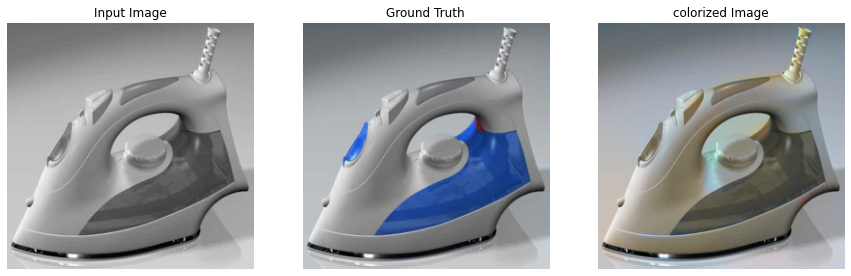

Time for epoch 66 is 69.46149778366089 sec


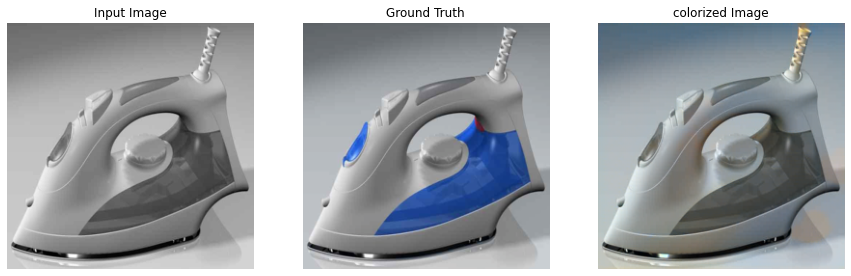

Time for epoch 71 is 69.16463375091553 sec


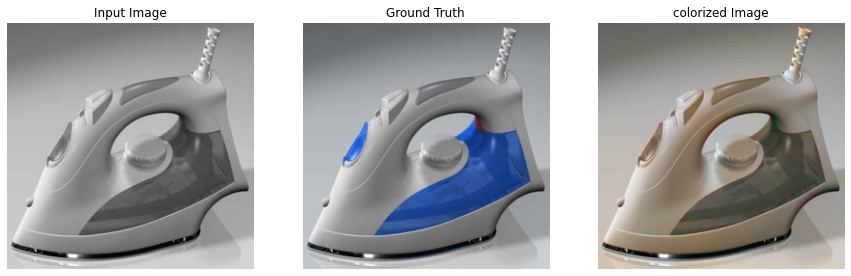

Time for epoch 76 is 69.65800404548645 sec


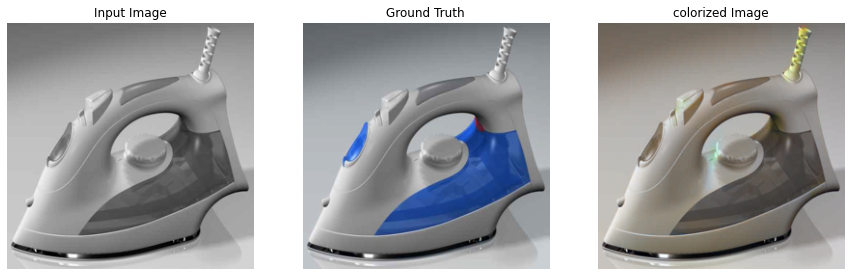

Time for epoch 81 is 69.29382848739624 sec


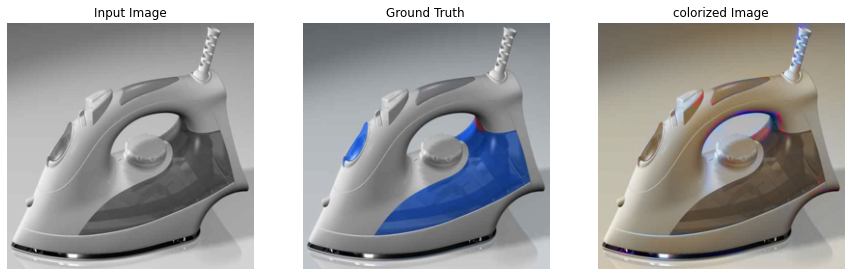

Time for epoch 86 is 69.5086019039154 sec


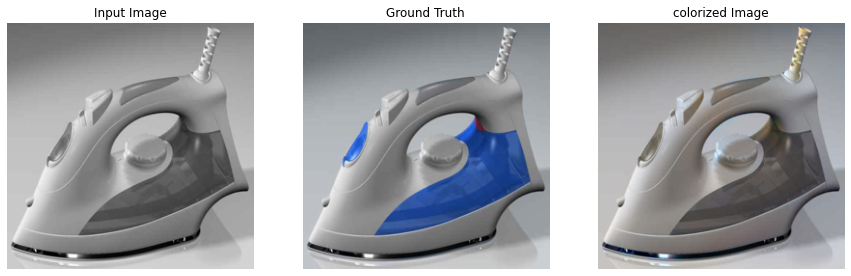

Time for epoch 91 is 70.22642922401428 sec


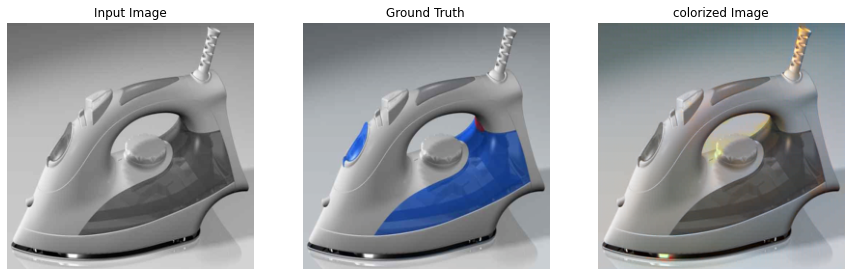

Time for epoch 96 is 69.77016234397888 sec


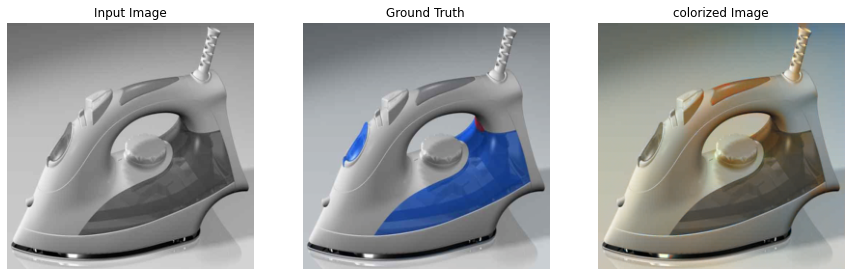

Total runtime for 100 epoches is 6933.856129169464 sec


In [12]:
epochs = 100
gloss_train, dloss_train, gloss_valid, dloss_valid = train(data_train, data_val, val_visual,
                                                            epochs,
                                                            generator,discriminator, 
                                                            dis_opt, gen_opt,device)

## Evaluation
check the grnerator and discriminator losses and the overfit, caculate FID and Inception scores

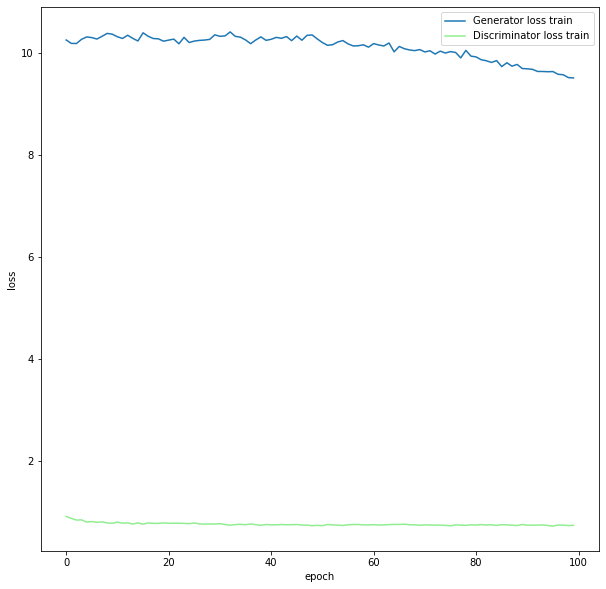

<Figure size 432x288 with 0 Axes>

In [13]:
### Generator and Discriminator losses

plt.figure(figsize=(10,10))
plt.plot(gloss_train, label="Generator loss train")
plt.plot(dloss_train, label="Discriminator loss train",color ='lightgreen')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend()
plt.show()
plt.savefig('G_D_l.png')

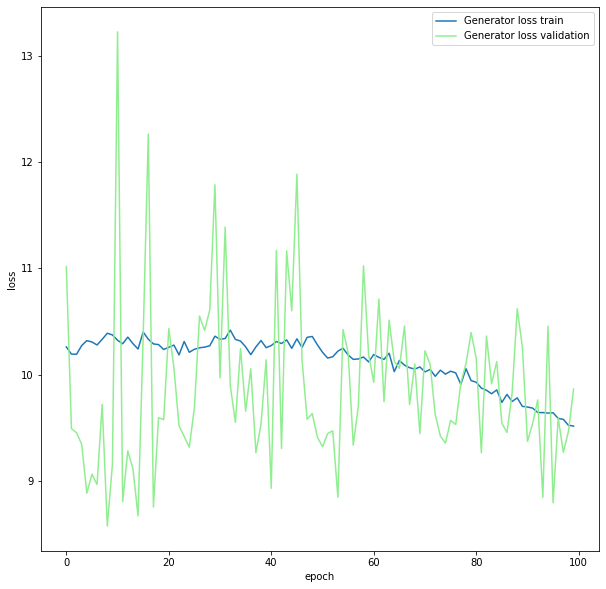

<Figure size 432x288 with 0 Axes>

In [14]:
### Generator losse for train and validation

plt.figure(figsize=(10,10))
plt.plot(gloss_train, label="Generator loss train")
plt.plot(gloss_valid, label="Generator loss validation",color ='lightgreen')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend()
plt.show()
plt.savefig('G_tv_l.png')

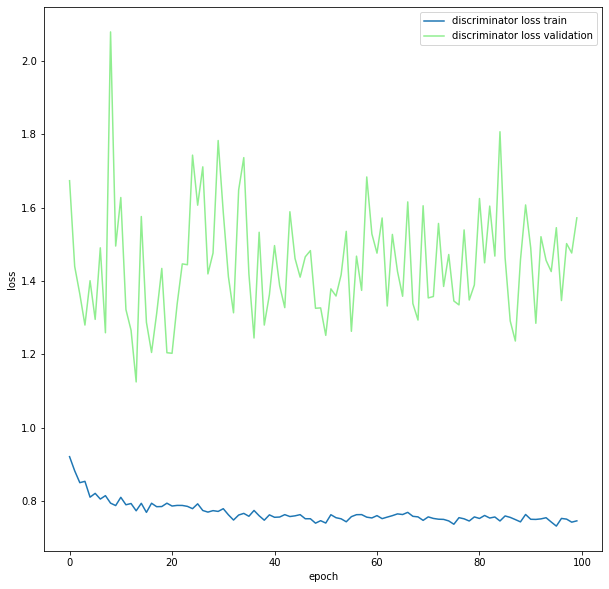

<Figure size 432x288 with 0 Axes>

In [15]:
### Discriminator losse for train and validation

plt.figure(figsize=(10,10))
plt.plot(dloss_train, label="discriminator loss train")
plt.plot(dloss_valid, label="discriminator loss validation",color ='lightgreen')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend()
plt.show()
plt.savefig('D_tv_l.png')

In [16]:
### getting data for evaluation

PATH = ['/content/drive/MyDrive/imagenet-mini/train', '/content/drive/MyDrive/imagenet-mini/val']
number_of_data= [1,520]
saving = [False, False]
batch_size = [2,1]

d, val_data, real_raw_FID, dt = data(PATH, number_of_data, saving, batch_size)
print(len(d))
print(len(val_data))
print(len(real_raw_FID))
print(len(dt))

0
500
500
20


In [17]:
### getting fake data for evaluation

generator.eval()
fake_raw_FID = []
for input_image, target in val_data:
  input = input_image.to(device)
  with torch.no_grad():
    gen_output = generator(input)
  fake_raw_FID .append([input, gen_output.detach()])  

In [18]:
from data_FID_IS import data_FID

list_image_real = real_raw_FID
list_image_fake = fake_raw_FID

real_FID , fake_FID = data_FID(list_image_real, list_image_fake, device)

In [19]:
### FID score
from torchmetrics.image.fid import FrechetInceptionDistance

fid = FrechetInceptionDistance(feature=2048,normalize = True).to(device)
fid.update(fake_FID, real=False)
fid.update(real_FID, real=True)
fid.compute()

tensor(1.9174, device='cuda:0')

In [20]:
### inception score
from torchmetrics.image.inception import InceptionScore

inception = InceptionScore(feature = 2048, normalize=True).to(device)
inception.update(fake_FID)
inception.compute()


/usr/local/lib/python3.8/dist-packages/torchmetrics/utilities/prints.py:36: UserWarning: Metric `InceptionScore` will save all extracted features in buffer. For large datasets this may lead to large memory footprint.
  warnings.warn(*args, **kwargs)


(tensor(1.0812, device='cuda:0'), tensor(0.0092, device='cuda:0'))

## Test

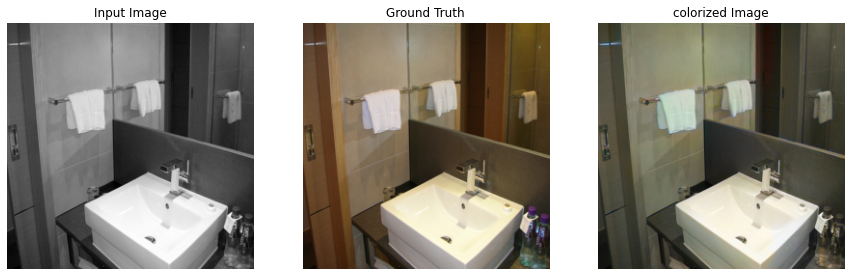

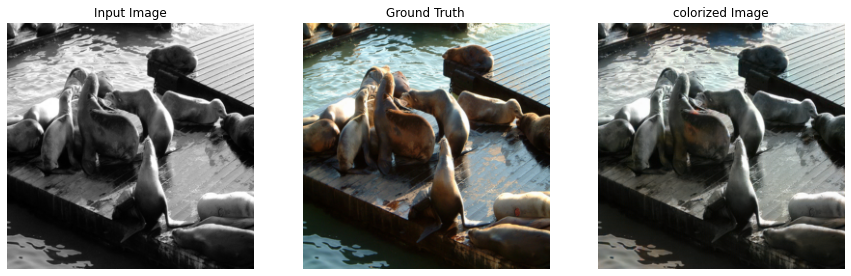

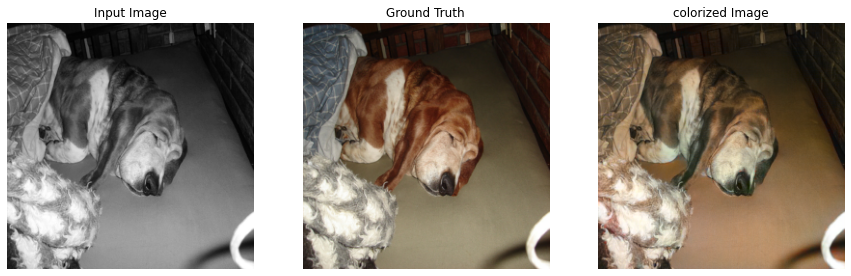

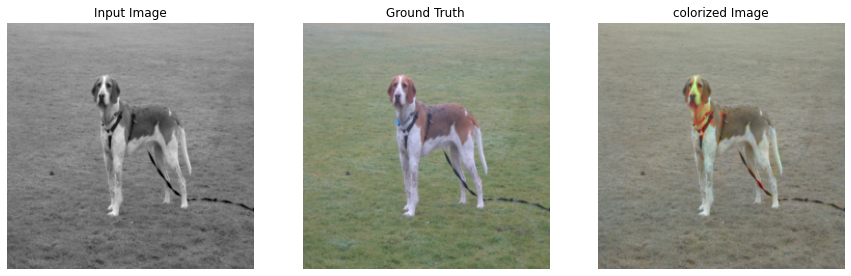

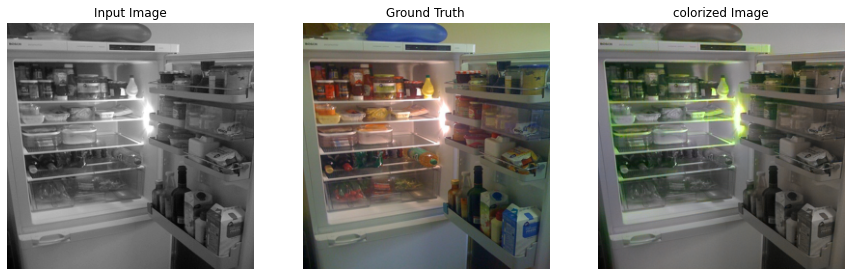

...

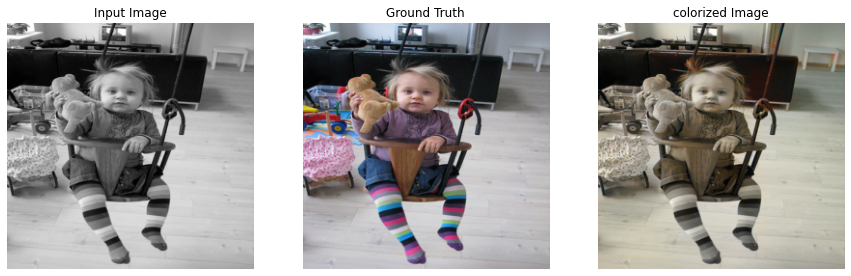

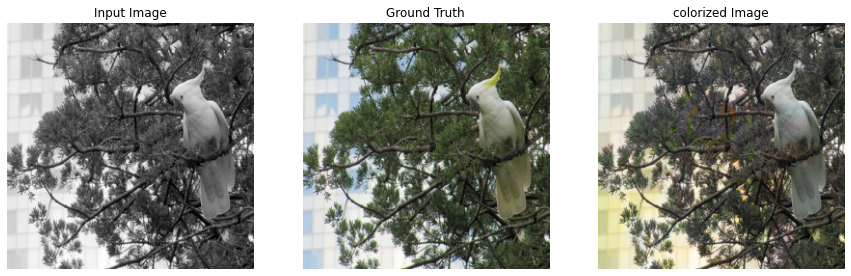

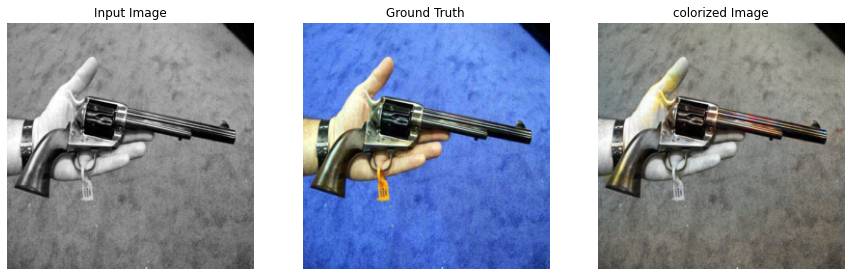

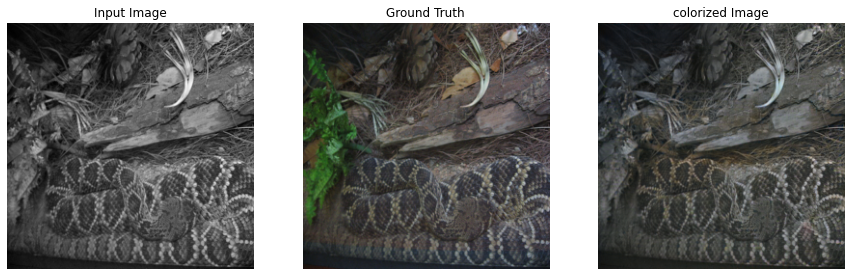

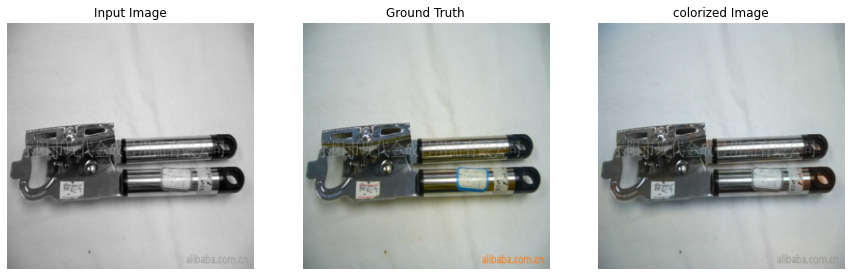

In [21]:
### getting fake image for test

num = 200
for input_test, target_test in data_test:
  num = num+1
  generate_images(generator, input_test, target_test, num, device)

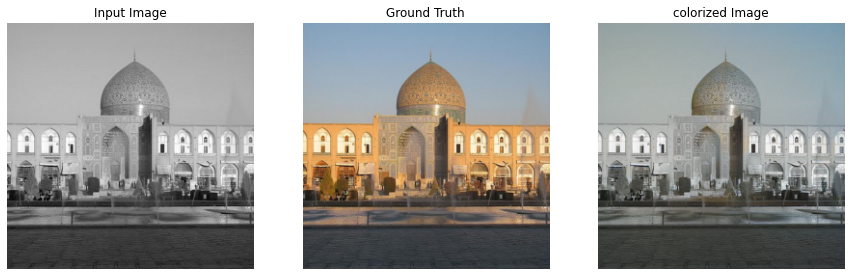

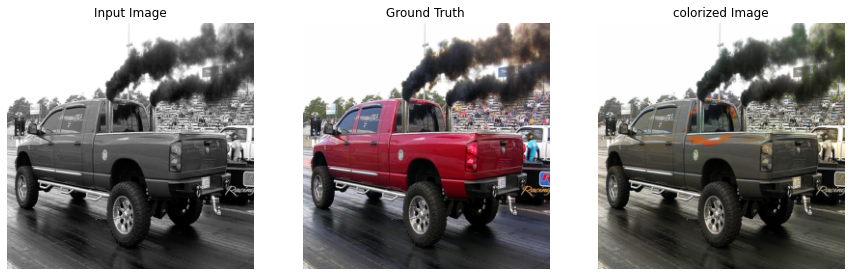

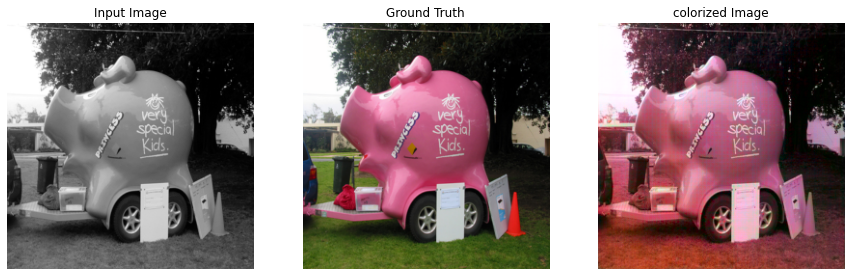

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


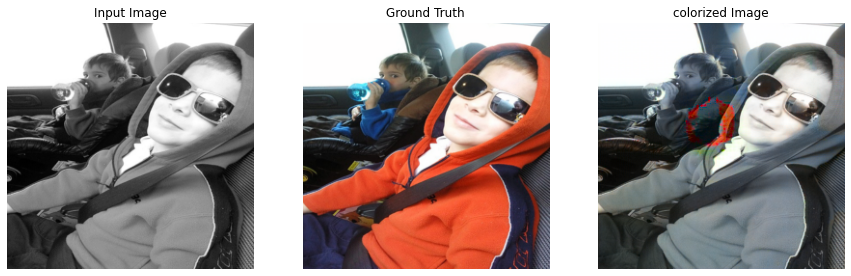

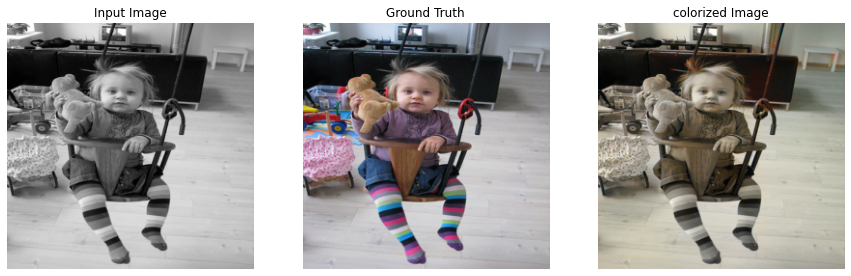

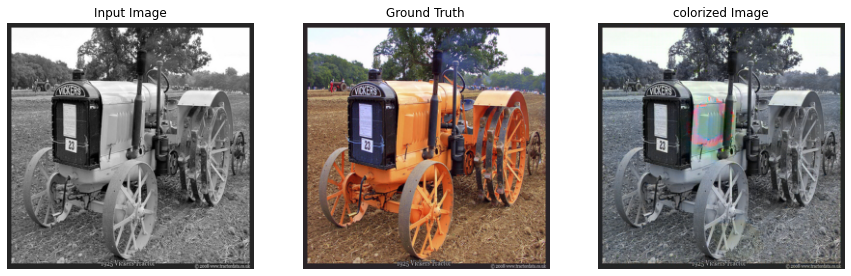

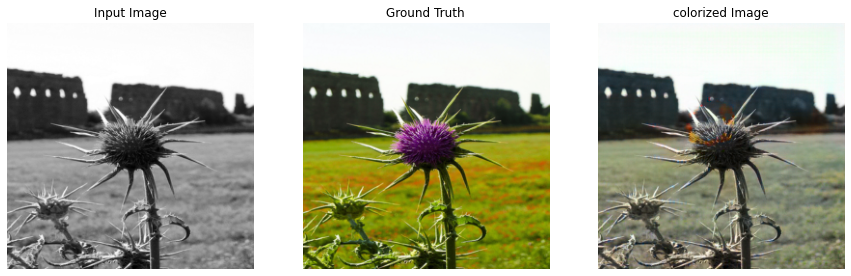

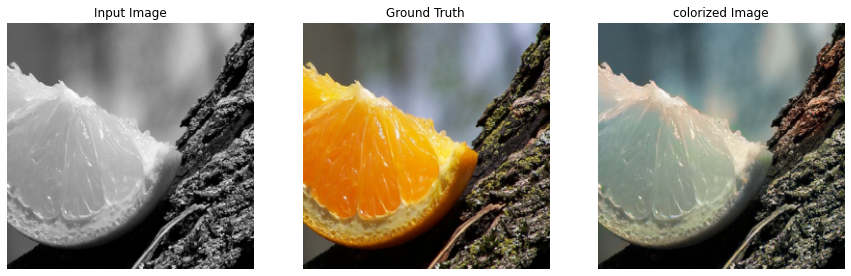

...

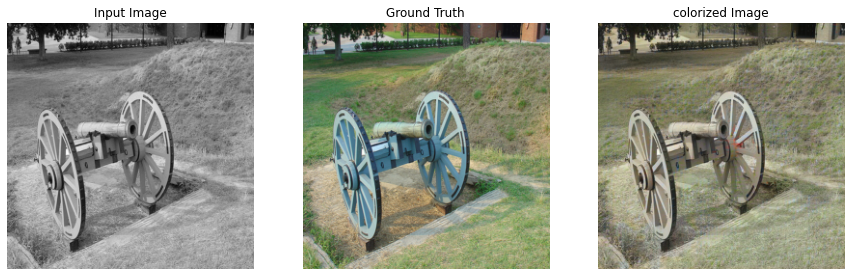

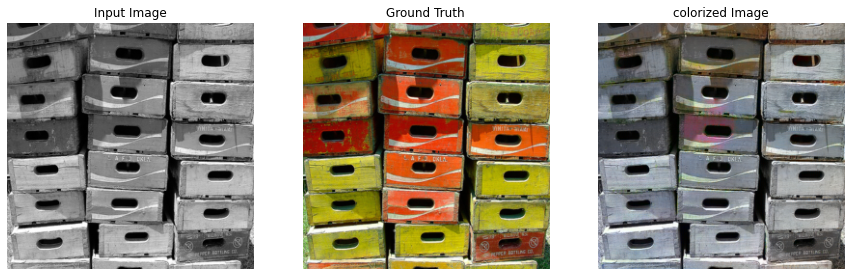

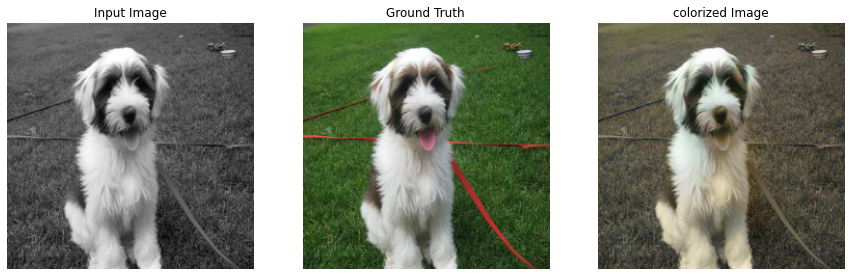

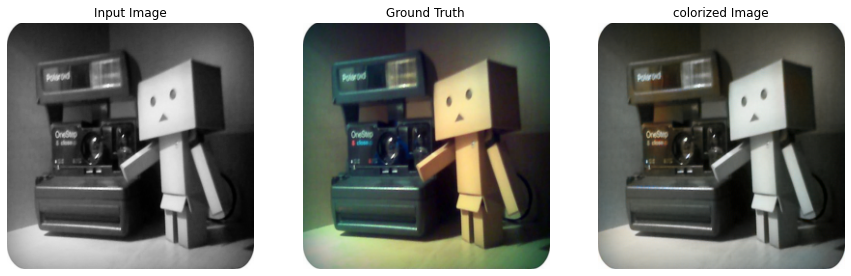

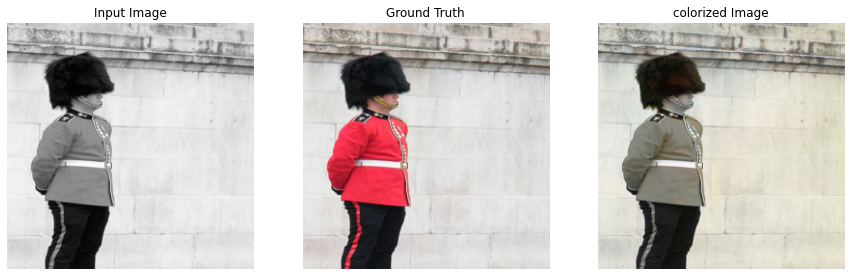

In [22]:
### getting some image for demo
from load_data import Imagenetmini
path_demo = ['/content/drive/MyDrive/imagenet-mini/val/n03788195/ILSVRC2012_val_00038331.JPEG',
             '/content/drive/MyDrive/imagenet-mini/val/n03930630/ILSVRC2012_val_00023096.JPEG',
             '/content/drive/MyDrive/imagenet-mini/val/n03935335/ILSVRC2012_val_00035065.JPEG',
             '/content/drive/MyDrive/imagenet-mini/val/n04162706/ILSVRC2012_val_00029582.JPEG',
             '/content/drive/MyDrive/imagenet-mini/val/n04371774/ILSVRC2012_val_00027173.JPEG',
             '/content/drive/MyDrive/imagenet-mini/val/n04465501/ILSVRC2012_val_00035513.JPEG',
             '/content/drive/MyDrive/imagenet-mini/val/n07730033/ILSVRC2012_val_00004728.JPEG',
             '/content/drive/MyDrive/imagenet-mini/val/n07747607/ILSVRC2012_val_00045114.JPEG',
             '/content/drive/MyDrive/imagenet-mini/val/n09193705/ILSVRC2012_val_00003084.JPEG',
             '/content/drive/MyDrive/imagenet-mini/val/n02808304/ILSVRC2012_val_00049724.JPEG',
             '/content/drive/MyDrive/imagenet-mini/val/n02403003/ILSVRC2012_val_00001280.JPEG',
             '/content/drive/MyDrive/imagenet-mini/val/n02128925/ILSVRC2012_val_00049347.JPEG',
             '/content/drive/MyDrive/imagenet-mini/val/n02727426/ILSVRC2012_val_00036882.JPEG',
             '/content/drive/MyDrive/imagenet-mini/val/n02814533/ILSVRC2012_val_00015651.JPEG',
             '/content/drive/MyDrive/imagenet-mini/val/n02906734/ILSVRC2012_val_00041911.JPEG',
             '/content/drive/MyDrive/imagenet-mini/val/n02950826/ILSVRC2012_val_00036357.JPEG',
             '/content/drive/MyDrive/imagenet-mini/val/n02971356/ILSVRC2012_val_00041631.JPEG',
             '/content/drive/MyDrive/imagenet-mini/val/n02097474/ILSVRC2012_val_00011895.JPEG',
             '/content/drive/MyDrive/imagenet-mini/val/n03976467/ILSVRC2012_val_00016006.JPEG',
             '/content/drive/MyDrive/imagenet-mini/val/n02817516/ILSVRC2012_val_00029927.JPEG']
             
demo_data = Imagenetmini(path_demo, train_mode = False)
num = 300
for input_demo, target_demo in demo_data:
  num = num+1
  generate_images(generator, input_demo, target_demo, num, device)